In [214]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt 
import folium
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans,AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram

from ClusterFunctions import print_boxplots,make_map, draw_clusters,filter_clusters_by_roadID,convert_column_to_string,analyse_attributes_values_in_clusters,draw_more_frequent_anomalies_clusters,draw_less_frequent_anomalies_clusters


%matplotlib inline
pd.set_option('display.width', 1000)
pd.options.display.max_columns = None

# Load data

In [2]:
caracteristics=pd.read_csv('Data\caracteristics.csv', encoding='latin-1')
caracteristics.dropna(inplace=True)
caracteristics.reindex()
caracteristics.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 223493 entries, 0 to 839572
Data columns (total 16 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   Num_Acc  223493 non-null  int64  
 1   an       223493 non-null  int64  
 2   mois     223493 non-null  int64  
 3   jour     223493 non-null  int64  
 4   hrmn     223493 non-null  int64  
 5   lum      223493 non-null  int64  
 6   agg      223493 non-null  int64  
 7   int      223493 non-null  int64  
 8   atm      223493 non-null  float64
 9   col      223493 non-null  float64
 10  com      223493 non-null  float64
 11  adr      223493 non-null  object 
 12  gps      223493 non-null  object 
 13  lat      223493 non-null  float64
 14  long     223493 non-null  object 
 15  dep      223493 non-null  int64  
dtypes: float64(4), int64(9), object(3)
memory usage: 29.0+ MB


In [3]:
caracteristics.describe(include='all')

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,com,adr,gps,lat,long,dep
count,2.234930e+05,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493,223493,2.234930e+05,223493.0,223493.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,156751,9,NaN,116350.0,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,A4,M,NaN,0.0,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1005,216574,NaN,44780.0,NaN
mean,2.011772e+11,11.772136,6.583754,15.556957,1387.027773,1.901299,1.773443,1.733598,1.542603,4.128921,196.355157,NaN,NaN,3.277844e+06,NaN,526.958106
std,3.371611e+08,3.371662,3.380630,8.762770,535.366688,1.522132,0.418605,1.594964,1.591858,2.006971,170.049420,NaN,NaN,2.149108e+06,NaN,284.559494
min,2.005000e+11,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,NaN,NaN,0.000000e+00,NaN,10.000000
25%,2.009001e+11,9.000000,4.000000,8.000000,1008.000000,1.000000,2.000000,1.000000,1.000000,3.000000,55.000000,NaN,NaN,4.000000e+00,NaN,300.000000
50%,2.012000e+11,12.000000,7.000000,15.000000,1500.000000,1.000000,2.000000,1.000000,1.000000,3.000000,149.000000,NaN,NaN,4.504770e+06,NaN,510.000000
75%,2.015000e+11,15.000000,10.000000,23.000000,1810.000000,2.000000,2.000000,2.000000,1.000000,6.000000,282.000000,NaN,NaN,4.852889e+06,NaN,770.000000


In [4]:
caracteristics['long']=caracteristics['long'].apply(pd.to_numeric,errors='ignore')
object_types=caracteristics['long'].apply(type)

indices = [i for i, x in enumerate(list(object_types)) if x == str]
print(f'droped str data: {len(indices)}')

caracteristics.drop(caracteristics.index[indices], inplace=True)
caracteristics['long']=caracteristics['long'].apply(pd.to_numeric,errors='ignore')
caracteristics['long']=caracteristics['long'].div(100000)
caracteristics['lat']=caracteristics['lat'].div(100000)
caracteristics.info()

droped str data: 2202
<class 'pandas.core.frame.DataFrame'>
Int64Index: 221291 entries, 0 to 839572
Data columns (total 16 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   Num_Acc  221291 non-null  int64  
 1   an       221291 non-null  int64  
 2   mois     221291 non-null  int64  
 3   jour     221291 non-null  int64  
 4   hrmn     221291 non-null  int64  
 5   lum      221291 non-null  int64  
 6   agg      221291 non-null  int64  
 7   int      221291 non-null  int64  
 8   atm      221291 non-null  float64
 9   col      221291 non-null  float64
 10  com      221291 non-null  float64
 11  adr      221291 non-null  object 
 12  gps      221291 non-null  object 
 13  lat      221291 non-null  float64
 14  long     221291 non-null  float64
 15  dep      221291 non-null  int64  
dtypes: float64(5), int64(9), object(2)
memory usage: 28.7+ MB


In [5]:
caracteristics.describe(include='all')

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,com,adr,gps,lat,long,dep
count,2.212910e+05,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291,221291,221291.000000,221291.000000,221291.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,155148,9,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,A4,M,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1005,214372,NaN,NaN,NaN
mean,2.011800e+11,11.799721,6.582125,15.557167,1386.850143,1.901447,1.772621,1.732343,1.541581,4.129427,195.788351,NaN,NaN,33.104605,1.845747,527.091016
std,3.376930e+08,3.376980,3.380758,8.761904,535.480250,1.521912,0.419141,1.594619,1.590445,2.007123,169.974889,NaN,NaN,21.346301,4.229032,285.433025
min,2.005000e+11,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,NaN,NaN,0.000000,-5.246000,10.000000
25%,2.009001e+11,9.000000,4.000000,8.000000,1005.000000,1.000000,2.000000,1.000000,1.000000,3.000000,55.000000,NaN,NaN,0.000040,0.000000,300.000000
50%,2.012000e+11,12.000000,7.000000,15.000000,1500.000000,1.000000,2.000000,1.000000,1.000000,3.000000,149.000000,NaN,NaN,45.155100,1.113000,510.000000
75%,2.015000e+11,15.000000,10.000000,23.000000,1810.000000,2.000000,2.000000,2.000000,1.000000,6.000000,281.000000,NaN,NaN,48.553295,3.223210,770.000000


### Select only accidents near Paris

In [6]:
paris_caracteristics=caracteristics.iloc[np.where((caracteristics['lat']>=48) & (caracteristics['lat']<=49.5) & (caracteristics['long']<=3.5) & (caracteristics['long']>1.5))]
paris_caracteristics

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,com,adr,gps,lat,long,dep
362,201600000363,16,2,19,1845,5,2,1,1.0,6.0,602.0,Rue du 7° BCA,M,49.48930,3.44609,20
402,201600000403,16,11,19,600,3,2,1,1.0,6.0,71.0,21 rue du pont araby,M,49.41023,3.13601,20
410,201600000411,16,4,18,815,1,2,1,1.0,6.0,810.0,AVENUE DE COMPIEGNE,M,49.25664,3.08494,20
411,201600000412,16,5,1,1445,1,2,1,1.0,3.0,307.0,"2, rue de verdun",M,49.17802,3.12734,20
437,201600000438,16,6,9,1615,1,2,1,1.0,2.0,628.0,rue du général de gaulle,M,49.42011,2.15253,600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
832402,200500079444,5,12,2,830,1,2,1,2.0,6.0,584.0,LE PETIT THERAIN,M,49.24000,2.44000,600
832417,200500079459,5,12,21,1715,3,1,3,8.0,1.0,580.0,Carrefour les Guepelles,M,49.09100,2.55200,950
832543,200500079585,5,12,10,1915,5,2,1,1.0,3.0,353.0,RN1/RUE DE BEAUMONT,M,49.08700,2.31500,950
832581,200500079623,5,12,22,530,3,1,1,1.0,6.0,399.0,PK 69+800,M,48.25000,3.35300,890


### Merge with places data

In [7]:
places=pd.read_csv('Data\places.csv')

In [8]:
paris_data = pd.merge(left=paris_caracteristics, right=places, left_on='Num_Acc', right_on='Num_Acc')

In [9]:
paris_data.dropna(subset=['surf'], inplace=True)
paris_data['voie']=paris_data['voie'].astype('int32',errors='ignore').astype('str',errors='ignore')
paris_data

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,com,adr,gps,lat,long,dep,catr,voie,v1,v2,circ,nbv,pr,pr1,vosp,prof,plan,lartpc,larrout,surf,infra,situ,env1
0,201600000363,16,2,19,1845,5,2,1,1.0,6.0,602.0,Rue du 7° BCA,M,49.48930,3.44609,20,3.0,26,NaN,NaN,2.0,2.0,4.0,700.0,0.0,1.0,1.0,0.0,70.0,1.0,0.0,1.0,99.0
1,201600000403,16,11,19,600,3,2,1,1.0,6.0,71.0,21 rue du pont araby,M,49.41023,3.13601,20,3.0,139,NaN,NaN,2.0,2.0,NaN,NaN,0.0,1.0,1.0,0.0,120.0,1.0,0.0,4.0,99.0
2,201600000411,16,4,18,815,1,2,1,1.0,6.0,810.0,AVENUE DE COMPIEGNE,M,49.25664,3.08494,20,3.0,973,NaN,NaN,2.0,2.0,NaN,NaN,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,3.0
3,201600000412,16,5,1,1445,1,2,1,1.0,3.0,307.0,"2, rue de verdun",M,49.17802,3.12734,20,3.0,17,NaN,NaN,2.0,2.0,NaN,NaN,0.0,1.0,1.0,0.0,59.0,1.0,0.0,1.0,99.0
4,201600000438,16,6,9,1615,1,2,1,1.0,2.0,628.0,rue du général de gaulle,M,49.42011,2.15253,600,4.0,nan,NaN,NaN,2.0,2.0,NaN,NaN,0.0,2.0,1.0,0.0,0.0,1.0,0.0,1.0,99.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34215,200500079444,5,12,2,830,1,2,1,2.0,6.0,584.0,LE PETIT THERAIN,M,49.24000,2.44000,600,3.0,92.0,0.0,NaN,2.0,2.0,0.0,0.0,0.0,1.0,1.0,0.0,65.0,2.0,0.0,1.0,0.0
34216,200500079459,5,12,21,1715,3,1,3,8.0,1.0,580.0,Carrefour les Guepelles,M,49.09100,2.55200,950,3.0,16.0,0.0,NaN,2.0,2.0,0.0,0.0,0.0,1.0,1.0,0.0,140.0,2.0,0.0,1.0,0.0
34217,200500079585,5,12,10,1915,5,2,1,1.0,3.0,353.0,RN1/RUE DE BEAUMONT,M,49.08700,2.31500,950,2.0,1.0,0.0,NaN,3.0,0.0,0.0,0.0,0.0,1.0,1.0,10.0,120.0,0.0,5.0,1.0,0.0
34218,200500079623,5,12,22,530,3,1,1,1.0,6.0,399.0,PK 69+800,M,48.25000,3.35300,890,1.0,5.0,0.0,NaN,3.0,2.0,69.0,800.0,0.0,2.0,1.0,30.0,70.0,1.0,0.0,1.0,0.0


In [10]:
paris_data.describe(include='all')

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,com,adr,gps,lat,long,dep,catr,voie,v1,v2,circ,nbv,pr,pr1,vosp,prof,plan,lartpc,larrout,surf,infra,situ,env1
count,3.410400e+04,34104.000000,34104.000000,34104.000000,34104.000000,34104.000000,34104.000000,34104.000000,34104.000000,34104.000000,34104.000000,34104,34104,34104.000000,34104.000000,34104.000000,34104.000000,34104,1116.000000,1037,34101.000000,34090.000000,21524.000000,21499.000000,34081.000000,34100.000000,34099.000000,30635.000000,30668.000000,34104.000000,34078.000000,34099.000000,34099.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19518,1,NaN,NaN,NaN,NaN,618,NaN,36,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AUTOROUTE A86,M,NaN,NaN,NaN,NaN,nan,NaN,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,835,34104,NaN,NaN,NaN,NaN,9841,NaN,193,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,2.013281e+11,13.280055,5.877316,15.502023,1378.238535,1.930448,1.723170,1.834418,1.533984,4.172854,161.263928,NaN,NaN,48.841959,2.375924,857.804070,3.039995,NaN,0.162186,NaN,1.905809,2.350132,8.591526,276.629797,0.108976,1.136921,1.129095,7.082846,61.195057,1.255923,0.460825,1.091762,58.188246
std,2.618567e+08,2.618565,3.291125,8.794386,548.185699,1.557931,0.447438,1.499220,1.525537,1.855844,179.574865,NaN,NaN,0.176770,0.229531,135.221703,1.218997,NaN,0.832977,NaN,0.809537,1.374822,30.178370,317.599243,0.521972,0.524698,0.607491,21.199568,64.564992,0.818666,1.350564,0.632518,48.494240
min,2.005000e+11,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,NaN,48.000000,1.500250,20.000000,1.000000,NaN,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.011001e+11,11.000000,3.000000,8.000000,940.000000,1.000000,1.000000,1.000000,1.000000,3.000000,42.000000,NaN,NaN,48.787300,2.289240,770.000000,2.000000,NaN,0.000000,NaN,1.000000,2.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000
50%,2.014000e+11,14.000000,6.000000,15.000000,1445.000000,1.000000,2.000000,1.000000,1.000000,3.000000,101.000000,NaN,NaN,48.850900,2.370680,930.000000,3.000000,NaN,0.000000,NaN,2.000000,2.000000,3.000000,150.000000,0.000000,1.000000,1.000000,0.000000,60.000000,1.000000,0.000000,1.000000,99.000000
75%,2.016000e+11,16.000000,9.000000,23.000000,1815.000000,2.000000,2.000000,2.000000,1.000000,6.000000,205.000000,NaN,NaN,48.928100,2.464360,940.000000,4.000000,NaN,0.000000,NaN,2.000000,3.000000,12.000000,500.000000,0.000000,1.000000,1.000000,10.000000,100.000000,1.000000,0.000000,1.000000,99.000000


In [11]:
paris_data['surf']=paris_data['surf'].replace(0.0,1.0)

In [12]:
#make_map(paris_data,number_of_points=200)

# DBSCAN 

In [177]:
kms_per_radian = 6371.0088
MIN_CLUSTER_SIZE=15
MAX_DISTANCE=.03
epsilon = MAX_DISTANCE / kms_per_radian

In [178]:
dbscan_data=paris_data.copy()

In [179]:
db = DBSCAN(eps=epsilon, min_samples=MIN_CLUSTER_SIZE, metric='haversine',n_jobs=-1).fit(np.radians(dbscan_data[['lat','long']].to_numpy()))

In [180]:
dbscan_data['cluster']=db.labels_
num_clusters = len(set(db.labels_))-1
num_clusters

73

In [181]:
#draw_clusters(dbscan_data)

In [182]:
dbscan_data=filter_clusters_by_roadID(dbscan_data,MIN_CLUSTER_SIZE)

In [18]:
#draw_clusters(dbscan_data)

# KMeans

In [12]:
kmeans_start_data=paris_data.copy()

In [13]:
kmeans_start_data.drop(['Num_Acc','dep','com','adr','gps','voie','v1','v2','pr','pr1'],axis=1,inplace=True)
kmeans_start_data.dropna(inplace=True)
kmeans_data=kmeans_start_data.copy()

In [14]:
convert_column_to_string(kmeans_start_data,['lum','int','atm','col','catr','circ','vosp','prof','plan','surf','situ'])
kmeans_start_data.describe(include='all')

,an,mois,jour,hrmn,lum,agg,int,atm,col,lat,long,catr,circ,nbv,vosp,prof,plan,lartpc,larrout,surf,infra,situ,env1
count,30599.000000,30599.000000,30599.000000,30599.000000,30599,30599.000000,30599,30599,30599,30599.000000,30599.000000,30599,30599,30599.000000,30599,30599,30599,30599.000000,30599.000000,30599,30599.000000,30599,30599.000000
unique,NaN,NaN,NaN,NaN,5,NaN,9,9,7,NaN,NaN,7,5,NaN,4,5,5,NaN,NaN,9,NaN,6,NaN
top,NaN,NaN,NaN,NaN,1,NaN,1,1,6,NaN,NaN,4,2,NaN,0,1,1,NaN,NaN,1,NaN,1,NaN
freq,NaN,NaN,NaN,NaN,21208,NaN,19374,24148,9953,NaN,NaN,13441,14670,NaN,29027,25165,24994,NaN,NaN,23983,NaN,27698,NaN
mean,13.218242,5.774993,15.511324,1374.807968,NaN,1.712605,NaN,NaN,NaN,48.824776,2.386202,NaN,NaN,2.375339,NaN,NaN,NaN,7.088728,61.202262,NaN,0.471388,NaN,55.947122
std,2.698312,3.259411,8.786175,549.440770,NaN,0.452555,NaN,NaN,NaN,0.177138,0.234662,NaN,NaN,1.419683,NaN,NaN,NaN,21.210766,64.593067,NaN,1.361017,NaN,48.878815
min,5.000000,1.000000,1.000000,1.000000,NaN,1.000000,NaN,NaN,NaN,48.000000,1.500250,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,NaN,0.000000
25%,11.000000,3.000000,8.000000,940.000000,NaN,1.000000,NaN,NaN,NaN,48.777040,2.311435,NaN,NaN,2.000000,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,NaN,0.000000
50%,14.000000,5.000000,15.000000,1440.000000,NaN,2.000000,NaN,NaN,NaN,48.839800,2.379650,NaN,NaN,2.000000,NaN,NaN,NaN,0.000000,60.000000,NaN,0.000000,NaN,99.000000
75%,16.000000,8.000000,23.000000,1815.000000,NaN,2.000000,NaN,NaN,NaN,48.895000,2.470555,NaN,NaN,3.000000,NaN,NaN,NaN,10.000000,100.000000,NaN,0.000000,NaN,99.000000


In [15]:
kmeans_one_hot_data=pd.get_dummies(data=kmeans_start_data, columns=['lum', 'int','atm','col','catr','circ','vosp','prof','plan','surf','situ'])
kmeans_one_hot_data

,an,mois,jour,hrmn,agg,lat,long,nbv,lartpc,larrout,infra,env1,lum_1,lum_2,lum_3,lum_4,lum_5,int_1,int_2,int_3,int_4,int_5,int_6,int_7,int_8,int_9,atm_1,atm_2,atm_3,atm_4,atm_5,atm_6,atm_7,atm_8,atm_9,col_1,col_2,col_3,col_4,col_5,col_6,col_7,catr_1,catr_2,catr_3,catr_4,catr_5,catr_6,catr_9,circ_0,circ_1,circ_2,circ_3,circ_4,vosp_0,vosp_1,vosp_2,vosp_3,prof_0,prof_1,prof_2,prof_3,prof_4,plan_0,plan_1,plan_2,plan_3,plan_4,surf_1,surf_2,surf_3,surf_4,surf_5,surf_6,surf_7,surf_8,surf_9,situ_0,situ_1,situ_2,situ_3,situ_4,situ_5
0,16,2,19,1845,2,49.48930,3.44609,2.0,0.0,70.0,0.0,99.0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
1,16,11,19,600,2,49.41023,3.13601,2.0,0.0,120.0,0.0,99.0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,16,4,18,815,2,49.25664,3.08494,2.0,0.0,0.0,0.0,3.0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
3,16,5,1,1445,2,49.17802,3.12734,2.0,0.0,59.0,0.0,99.0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4,16,6,9,1615,2,49.42011,2.15253,2.0,0.0,0.0,0.0,99.0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34215,5,12,2,830,2,49.24000,2.44000,2.0,0.0,65.0,0.0,0.0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
34216,5,12,21,1715,1,49.09100,2.55200,2.0,0.0,140.0,0.0,0.0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
34217,5,12,10,1915,2,49.08700,2.31500,0.0,10.0,120.0,5.0,0.0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
34218,5,12,22,530,1,48.25000,3.35300,2.0,30.0,70.0,0.0,0.0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [16]:
scaler = StandardScaler()
kmeans_one_hot_data= scaler.fit_transform(kmeans_one_hot_data)
pca = PCA(.85)
kmeans_one_hot_data=pca.fit_transform(kmeans_one_hot_data)
kmeans_one_hot_data=pd.DataFrame(kmeans_one_hot_data)

In [73]:
kmeans_one_hot_data

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52
0,-0.849323,-0.464862,-0.577460,-0.976479,0.685552,1.284210,2.172161,0.841813,-0.604852,-0.308851,1.501093,0.262511,0.607631,-0.619029,-0.395229,-1.413339,0.384346,-0.432637,-0.695773,-0.774323,0.634967,-0.054926,-0.608931,-0.959636,0.172219,0.357046,-0.181869,-0.243231,0.089285,0.027146,-0.403274,-0.466841,-0.413487,0.758070,-0.839783,0.610912,0.774575,-0.063980,-0.212319,-0.913152,-0.044315,0.666530,1.420797,-0.715480,-0.756438,0.116894,0.370504,-0.846732,0.488990,-0.488471,0.532056,-0.603944,-0.464658
1,-0.260049,-0.236342,1.832211,-0.364483,2.630485,3.630798,2.425351,0.114972,-1.604549,-0.379947,-1.602162,-1.264419,-0.542806,-0.257482,-0.872764,-1.284285,1.198224,0.258473,-0.176035,-0.528268,-0.121386,-0.763898,-0.630273,-0.804542,1.911545,0.339526,-0.381883,-2.191499,0.225813,-0.578131,-0.300333,0.551962,0.086870,0.987102,0.035644,0.028682,-0.666323,-1.038495,-1.179375,1.201168,0.411337,1.446055,1.208219,-0.131309,-0.111830,-1.648569,-0.102388,0.301983,0.251214,1.628597,-3.583822,1.105588,3.258883
2,-1.223985,-0.876625,-0.150771,-1.246915,0.562775,1.236506,-0.842203,0.905236,-0.663588,-0.224830,0.507511,-0.162311,-0.120123,-0.218024,-0.447614,-0.789529,0.800013,-0.185730,-0.151525,-0.976571,0.146950,0.241015,0.082360,-0.150479,0.252542,-0.410862,0.085390,-0.358990,0.303159,-0.042209,-0.319898,-0.208253,-0.259833,0.152162,-0.603269,0.586836,0.018434,-0.193919,0.178824,-0.201903,0.070341,0.270742,0.876716,0.098988,-0.633938,-0.279174,0.284742,-0.590378,0.168275,-0.670282,0.035986,-0.267713,-0.027759
3,-0.720835,-1.301579,-0.983856,-1.321721,0.256590,0.031221,-0.487613,-0.396086,-0.413434,0.012425,-0.268178,0.758525,-0.486349,0.446737,0.092473,-1.401407,-0.209813,-0.578062,-0.102422,-0.714669,0.064781,-0.280153,-0.124916,-0.234477,0.457654,0.411710,-0.568354,-0.496906,0.396907,0.415639,0.007485,-0.262678,-0.715974,-0.068032,-1.229919,0.903631,-0.096240,-0.832026,-0.077464,-0.279801,-0.220397,0.843924,0.308642,0.259718,-0.499096,0.387181,-0.098173,-0.324002,0.676306,0.533477,0.194163,-0.610707,0.116437
4,-0.914618,-0.753498,0.508860,-0.243912,-0.693029,-1.384671,-0.446627,2.845176,-0.511158,-2.246759,-0.799895,0.653347,1.192619,-0.421336,-0.008818,1.221972,0.403264,-0.636885,-0.876757,0.280750,0.692443,-0.725583,1.362609,-0.220710,0.096656,-0.082594,-0.059989,-0.172991,0.579206,-0.135113,-0.112232,0.066756,-0.804568,-0.350183,0.291084,-0.175242,0.080526,0.160358,-0.314578,0.220639,-0.239097,-0.051981,-0.299858,0.357809,-0.155864,0.260468,-0.724306,0.775432,-0.040367,1.389514,0.176918,0.738192,-0.905631
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30594,0.061510,3.427550,-1.251059,-1.631440,0.797317,1.336108,-2.258926,0.195039,-0.696711,-0.515706,1.222545,0.386508,0.542787,-0.521179,-2.044519,-0.242660,0.162204,0.865377,-0.074138,-0.428643,-0.227922,-0.677525,0.187311,0.740172,0.688679,-1.097996,-0.213513,0.039737,0.267221,-0.169030,-0.335043,0.012117,-0.670419,-0.950441,-0.698136,0.338303,-0.611612,-0.071189,-0.023781,0.573805,-0.662624,0.011668,-0.321445,0.907561,-0.536513,-0.110482,-0.537586,0.092366,0.228473,1.247274,0.000722,0.528336,-0.266316
30595,0.747880,3.174519,-1.537478,-2.636083,1.576120,-0.032144,0.145304,-1.219658,-0.409497,-0.406962,0.919449,1.815389,-1.408610,0.322715,-0.772593,0.494246,1.603064,-0.789450,-0.118994,3.630031,-2.313160,0.379998,0.058716,-0.834282,0.542803,1.651246,0.723363,2.018157,-0.909735,-2.472547,-1.104083,-1.244418,0.435085,-0.340184,0.191199,1.639447,1.944119,-0.074182,-1.218154,-0.010859,-0.581927,-0.802662,0.077585,0.981811,-1.920884,-2.242790,-0.277264,0.806484,-0.036358,-0.029401,-2.295050,0.677336,1.810611
30596,0.248740,-0.999867,-0.527108,-0.883148,0.079675,-0.456030

In [26]:
inertias=[]
K = list(range(1,97,5))
for k in K:
    kmeans=KMeans(n_clusters=k, random_state=0).fit(kmeans_one_hot_data)
    inertias.append(kmeans.inertia_)

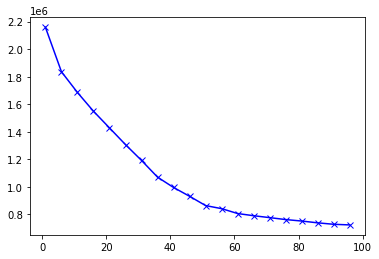

In [36]:
plt.plot(K,inertias, 'bx-')
plt.show()

In [17]:
kmeans=KMeans(n_clusters=50, random_state=0).fit(kmeans_one_hot_data)

In [18]:
kmeans_data['cluster']=kmeans.labels_

# Hierarchical clustering

In [74]:
hierarchical_start_data=paris_data.copy()
hierarchical_start_data.drop(['Num_Acc','dep','com','adr','gps','voie','v1','v2','pr','pr1'],axis=1,inplace=True)
hierarchical_start_data.dropna(inplace=True)

hierarchical_data=hierarchical_start_data.copy()

convert_column_to_string(hierarchical_start_data,['lum','int','atm','col','catr','circ','vosp','prof','plan','surf','situ'])
hierarchical_start_data.describe(include='all')

,an,mois,jour,hrmn,lum,agg,int,atm,col,lat,long,catr,circ,nbv,vosp,prof,plan,lartpc,larrout,surf,infra,situ,env1
count,30599.000000,30599.000000,30599.000000,30599.000000,30599,30599.000000,30599,30599,30599,30599.000000,30599.000000,30599,30599,30599.000000,30599,30599,30599,30599.000000,30599.000000,30599,30599.000000,30599,30599.000000
unique,NaN,NaN,NaN,NaN,5,NaN,9,9,7,NaN,NaN,7,5,NaN,4,5,5,NaN,NaN,9,NaN,6,NaN
top,NaN,NaN,NaN,NaN,1,NaN,1,1,6,NaN,NaN,4,2,NaN,0,1,1,NaN,NaN,1,NaN,1,NaN
freq,NaN,NaN,NaN,NaN,21208,NaN,19374,24148,9953,NaN,NaN,13441,14670,NaN,29027,25165,24994,NaN,NaN,23983,NaN,27698,NaN
mean,13.218242,5.774993,15.511324,1374.807968,NaN,1.712605,NaN,NaN,NaN,48.824776,2.386202,NaN,NaN,2.375339,NaN,NaN,NaN,7.088728,61.202262,NaN,0.471388,NaN,55.947122
std,2.698312,3.259411,8.786175,549.440770,NaN,0.452555,NaN,NaN,NaN,0.177138,0.234662,NaN,NaN,1.419683,NaN,NaN,NaN,21.210766,64.593067,NaN,1.361017,NaN,48.878815
min,5.000000,1.000000,1.000000,1.000000,NaN,1.000000,NaN,NaN,NaN,48.000000,1.500250,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,NaN,0.000000
25%,11.000000,3.000000,8.000000,940.000000,NaN,1.000000,NaN,NaN,NaN,48.777040,2.311435,NaN,NaN,2.000000,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,NaN,0.000000
50%,14.000000,5.000000,15.000000,1440.000000,NaN,2.000000,NaN,NaN,NaN,48.839800,2.379650,NaN,NaN,2.000000,NaN,NaN,NaN,0.000000,60.000000,NaN,0.000000,NaN,99.000000
75%,16.000000,8.000000,23.000000,1815.000000,NaN,2.000000,NaN,NaN,NaN,48.895000,2.470555,NaN,NaN,3.000000,NaN,NaN,NaN,10.000000,100.000000,NaN,0.000000,NaN,99.000000


In [77]:
hierarchical_one_hot_data=pd.get_dummies(data=hierarchical_start_data, columns=['lum', 'int','atm','col','catr','circ','vosp','prof','plan','surf','situ'])
hierarchical_one_hot_data

,an,mois,jour,hrmn,agg,lat,long,nbv,lartpc,larrout,infra,env1,lum_1,lum_2,lum_3,lum_4,lum_5,int_1,int_2,int_3,int_4,int_5,int_6,int_7,int_8,int_9,atm_1,atm_2,atm_3,atm_4,atm_5,atm_6,atm_7,atm_8,atm_9,col_1,col_2,col_3,col_4,col_5,col_6,col_7,catr_1,catr_2,catr_3,catr_4,catr_5,catr_6,catr_9,circ_0,circ_1,circ_2,circ_3,circ_4,vosp_0,vosp_1,vosp_2,vosp_3,prof_0,prof_1,prof_2,prof_3,prof_4,plan_0,plan_1,plan_2,plan_3,plan_4,surf_1,surf_2,surf_3,surf_4,surf_5,surf_6,surf_7,surf_8,surf_9,situ_0,situ_1,situ_2,situ_3,situ_4,situ_5
0,16,2,19,1845,2,49.48930,3.44609,2.0,0.0,70.0,0.0,99.0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
1,16,11,19,600,2,49.41023,3.13601,2.0,0.0,120.0,0.0,99.0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,16,4,18,815,2,49.25664,3.08494,2.0,0.0,0.0,0.0,3.0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
3,16,5,1,1445,2,49.17802,3.12734,2.0,0.0,59.0,0.0,99.0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4,16,6,9,1615,2,49.42011,2.15253,2.0,0.0,0.0,0.0,99.0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34215,5,12,2,830,2,49.24000,2.44000,2.0,0.0,65.0,0.0,0.0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
34216,5,12,21,1715,1,49.09100,2.55200,2.0,0.0,140.0,0.0,0.0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
34217,5,12,10,1915,2,49.08700,2.31500,0.0,10.0,120.0,5.0,0.0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
34218,5,12,22,530,1,48.25000,3.35300,2.0,30.0,70.0,0.0,0.0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [78]:
scaler = StandardScaler()
hierarchical_one_hot_data= scaler.fit_transform(hierarchical_one_hot_data)
pca = PCA(.9)
hierarchical_one_hot_data=pca.fit_transform(hierarchical_one_hot_data)
hierarchical_one_hot_data=pd.DataFrame(hierarchical_one_hot_data)
hierarchical_one_hot_data

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57
0,-0.849323,-0.464862,-0.577460,-0.976479,0.685552,1.284210,2.172161,0.841813,-0.604852,-0.308851,1.501093,0.262511,0.607631,-0.619029,-0.395229,-1.413339,0.384346,-0.432637,-0.695773,-0.774323,0.634967,-0.054926,-0.608931,-0.959636,0.172219,0.357046,-0.181869,-0.243231,0.089285,0.027146,-0.403274,-0.466841,-0.413487,0.758070,-0.839783,0.610912,0.774575,-0.063980,-0.212319,-0.913152,-0.044315,0.666530,1.420797,-0.715480,-0.756438,0.116894,0.370504,-0.846732,0.488990,-0.488471,0.532056,-0.603944,-0.464658,-1.328287,1.208335,1.784372,3.348086,-1.116741
1,-0.260049,-0.236342,1.832211,-0.364483,2.630485,3.630798,2.425351,0.114972,-1.604549,-0.379947,-1.602162,-1.264419,-0.542806,-0.257482,-0.872764,-1.284285,1.198224,0.258473,-0.176035,-0.528268,-0.121386,-0.763898,-0.630273,-0.804542,1.911545,0.339526,-0.381883,-2.191499,0.225813,-0.578131,-0.300333,0.551962,0.086870,0.987102,0.035644,0.028682,-0.666323,-1.038495,-1.179375,1.201168,0.411337,1.446055,1.208219,-0.131309,-0.111830,-1.648569,-0.102388,0.301983,0.251214,1.628597,-3.583822,1.105588,3.258883,1.297224,1.352503,1.744392,4.320010,-1.117723
2,-1.223985,-0.876625,-0.150771,-1.246915,0.562775,1.236506,-0.842203,0.905236,-0.663588,-0.224830,0.507511,-0.162311,-0.120123,-0.218024,-0.447614,-0.789529,0.800013,-0.185730,-0.151525,-0.976571,0.146950,0.241015,0.082360,-0.150479,0.252542,-0.410862,0.085390,-0.358990,0.303159,-0.042209,-0.319898,-0.208253,-0.259833,0.152162,-0.603269,0.586836,0.018434,-0.193919,0.178824,-0.201903,0.070341,0.270742,0.876716,0.098988,-0.633938,-0.279174,0.284742,-0.590378,0.168275,-0.670282,0.035986,-0.267713,-0.027759,-0.798679,1.548818,0.719787,2.273357,0.109850
3,-0.720835,-1.301579,-0.983856,-1.321721,0.256590,0.031221,-0.487613,-0.396086,-0.413434,0.012425,-0.268178,0.758525,-0.486349,0.446737,0.092473,-1.401407,-0.209813,-0.578062,-0.102422,-0.714669,0.064781,-0.280153,-0.124916,-0.234477,0.457654,0.411710,-0.568354,-0.496906,0.396907,0.415639,0.007485,-0.262678,-0.715974,-0.068032,-1.229919,0.903631,-0.096240,-0.832026,-0.077464,-0.279801,-0.220397,0.843924,0.308642,0.259718,-0.499096,0.387181,-0.098173,-0.324002,0.676306,0.533477,0.194163,-0.610707,0.116437,-1.217380,0.944609,1.100717,2.261776,-0.980907
4,-0.914618,-0.753498,0.508860,-0.243912,-0.693029,-1.384671,-0.446627,2.845176,-0.511158,-2.246759,-0.799895,0.653347,1.192619,-0.421336,-0.008818,1.221972,0.403264,-0.636885,-0.876757,0.280750,0.692443,-0.725583,1.362609,-0.220710,0.096656,-0.082594,-0.059989,-0.172991,0.579206,-0.135113,-0.112232,0.066756,-0.804568,-0.350183,0.291084,-0.175242,0.080526,0.160358,-0.314578,0.220639,-0.239097,-0.051981,-0.299858,0.357809,-0.155864,0.260468,-0.724306,0.775432,-0.040367,1.389514,0.176918,0.738192,-0.905631,-0.505801,0.197147,1.332314,1.667844,-1.832710
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30594,0.061510,3.427550,-1.251059,-1.631440,0.797317,1.336108,-2.258926,0.195039,-0.696711,-0.515706,1.222545,0.386508,0.542787,-0.521179,-2.044519,-0.242660,0.162204,0.865377,-0.074138,-0.428643,-0.227922,-0.677525,0.187311,0.740172,0.688679,-1.097996,-0.213513,0.039737,0.267221,-0.169030,-0.335043,0.012117,-0.670419,-0.950441,-0.698136,0.338303,-0.611612,-0.071189,-0.023781,0.573805,-0.662624,0.011668,-0.321445,0.907561,-0.536513,-0.110482,-0.537586,0.092366,0.228473,1.247274,0.000722,0.528336,-0.266316,0.009812,0.762710,-1.094728,1.988602,0.255781
30595,0.747880,3.174519,-1.537478,-2.636083,1.576120,-0.032144,0.145304,-1.219658,-0.409497,-0.406962,0.919449,1.815389,-1.408610,0.322715,-0.772593,0.494246,1.603064,-0.789450,-0.118994,3.630031,-2.313160,0.379998,0.058716,-0.834282,0.542803,1.651246,0.723363

In [46]:
hierarchical= AgglomerativeClustering(distance_threshold=0, n_clusters=None).fit(hierarchical_one_hot_data)

In [48]:
def plot_dendrogram(model, **kwargs):
    plt.rcParams["figure.figsize"] = (12,12)
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1
            else:
                current_count += counts[child_idx - n_samples]
                counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,counts]).astype(float)

    dendrogram(linkage_matrix, **kwargs)


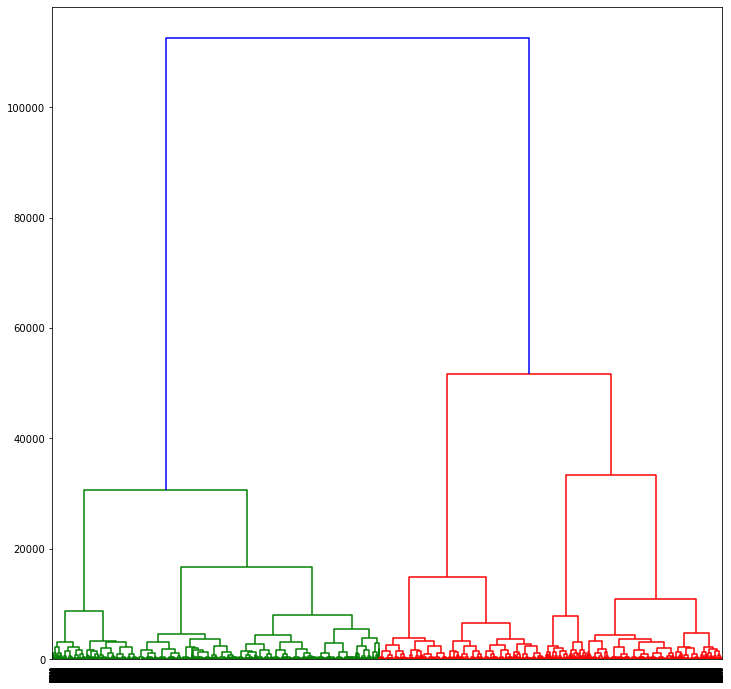

In [49]:
plot_dendrogram(hierarchical)

In [79]:
hierarchical= AgglomerativeClustering(n_clusters=4).fit(hierarchical_one_hot_data)

In [80]:
hierarchical_data['cluster']=hierarchical.labels_

# Analyse clustering data

## Attributes for analysis 
    - lum: Lighting conditions in which the accident occurred
    - atm: Atmospheric conditions
    - col: Type of collision
    - surf: Surface condition

## DBSCAN analysis

In [32]:
convert_column_to_string(dbscan_data,['lum','surf','atm','col'])

In [33]:
dbscan_data=dbscan_data.loc[dbscan_data['cluster']!=-1]

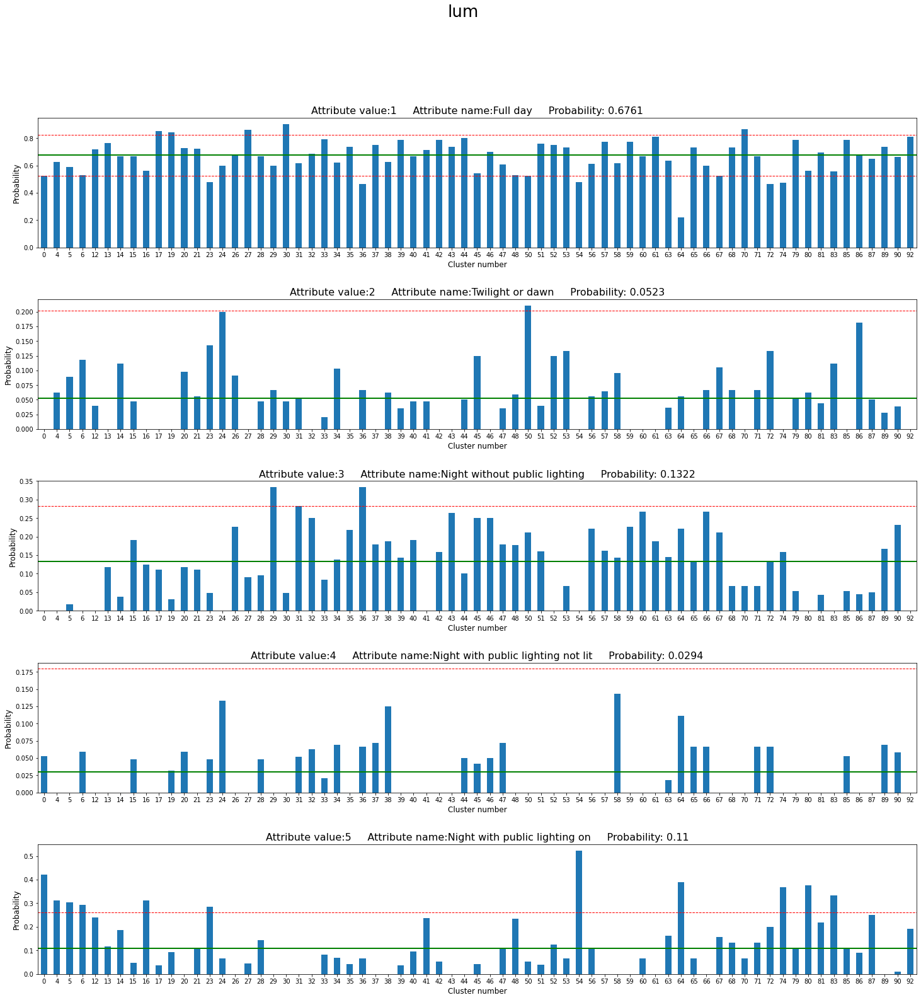

In [37]:
anomalies=analyse_attributes_values_in_clusters(dbscan_data,'lum',threshold=0.15)

In [91]:
#draw_more_frequent_anomalies_clusters(dbscan_data,anomalies,'lum')

In [92]:
#draw_less_frequent_anomalies_clusters(dbscan_data,anomalies,'lum')

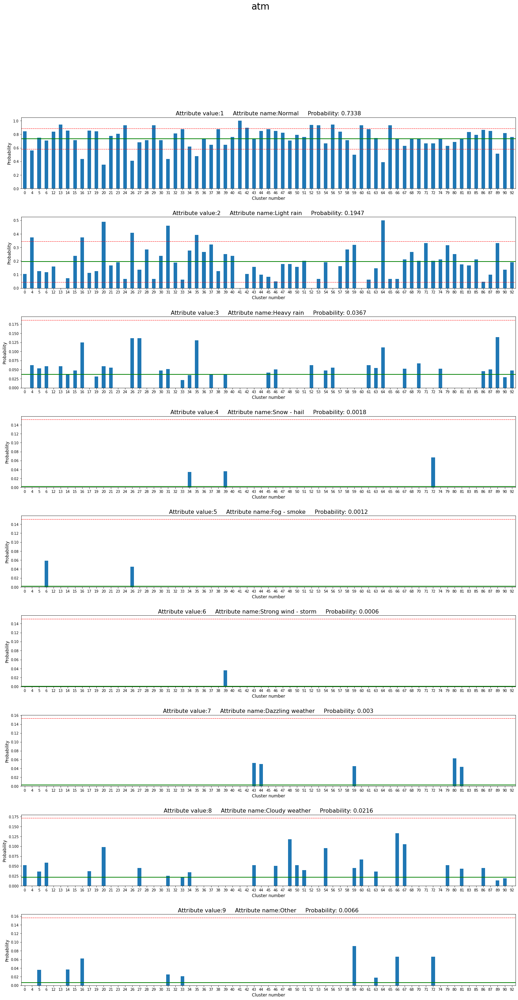

In [40]:
anomalies=analyse_attributes_values_in_clusters(dbscan_data,'atm',threshold=0.15)

In [93]:
#draw_more_frequent_anomalies_clusters(dbscan_data,anomalies,'atm')

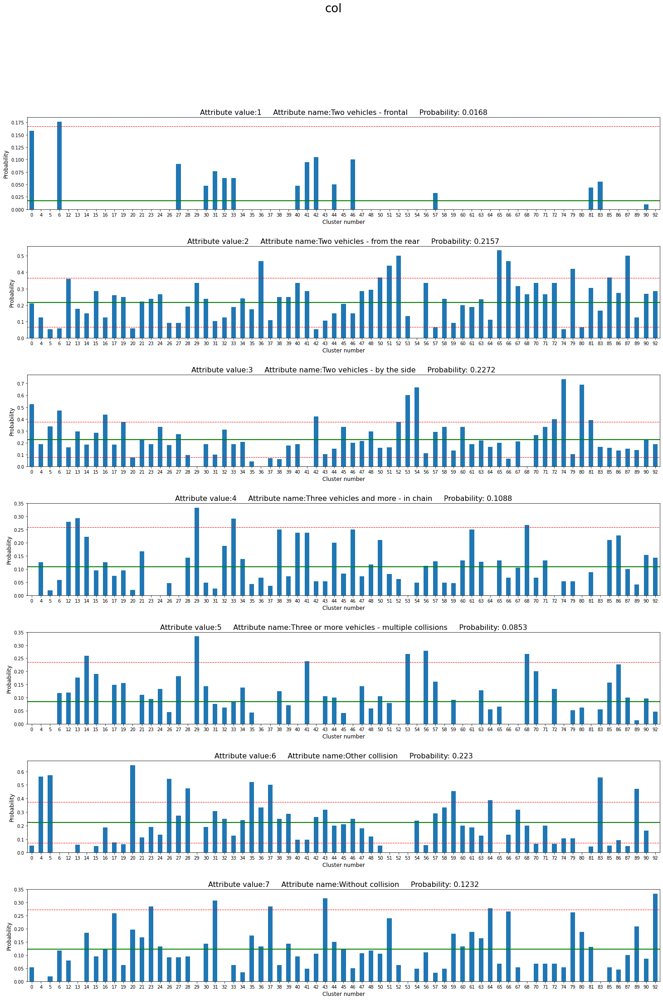

In [42]:
anomalies=analyse_attributes_values_in_clusters(dbscan_data,'col',threshold=0.15)

In [90]:
#draw_more_frequent_anomalies_clusters(dbscan_data,anomalies,'col')

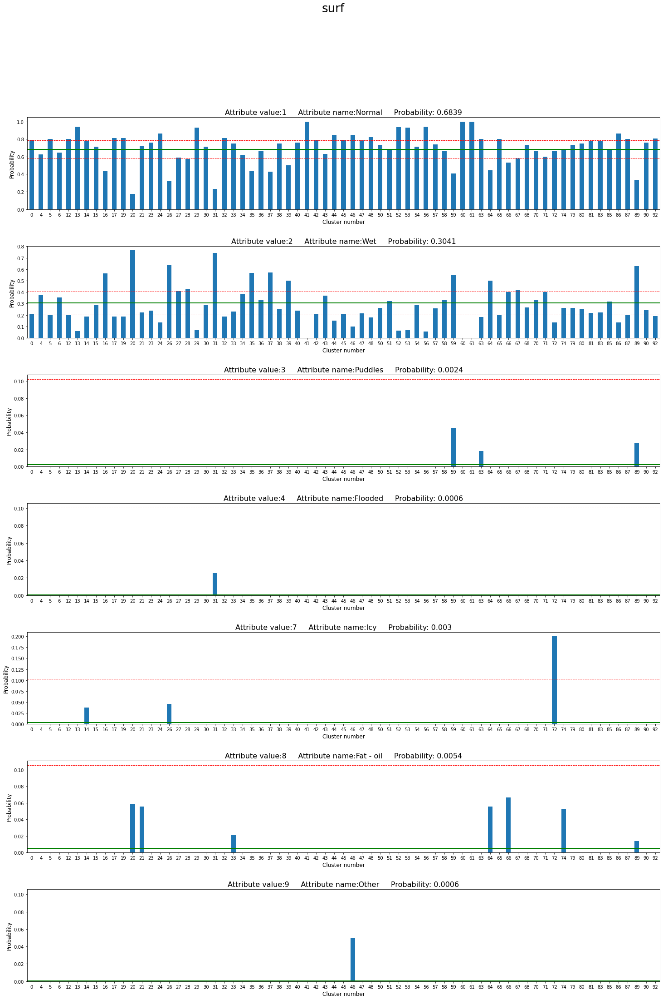

In [44]:
anomalies=analyse_attributes_values_in_clusters(dbscan_data,'surf',threshold=0.1)

In [94]:
#draw_more_frequent_anomalies_clusters(dbscan_data,anomalies,'surf')

## KMEANS analysis

In [19]:
convert_column_to_string(kmeans_data,['lum','surf','atm','col'])

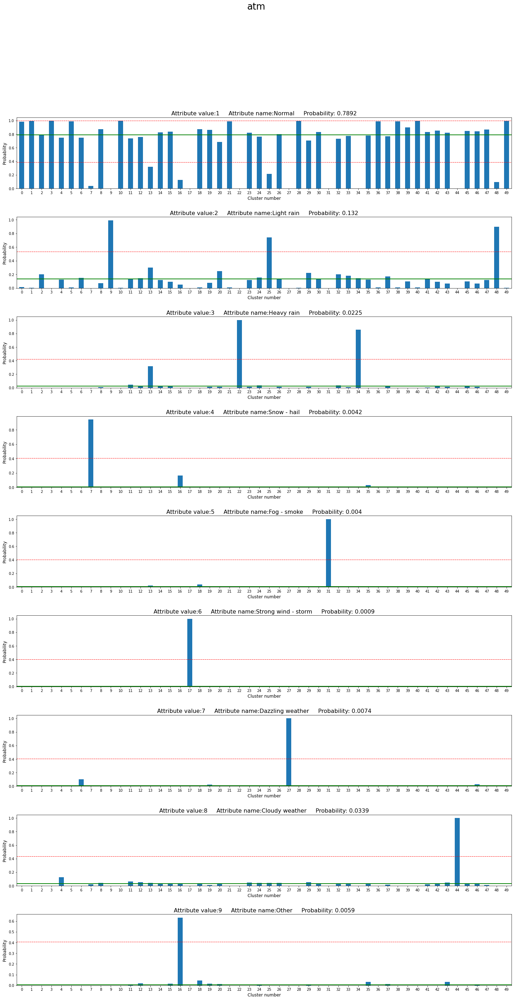

In [22]:
anomalies=analyse_attributes_values_in_clusters(kmeans_data,'atm',threshold=0.4)

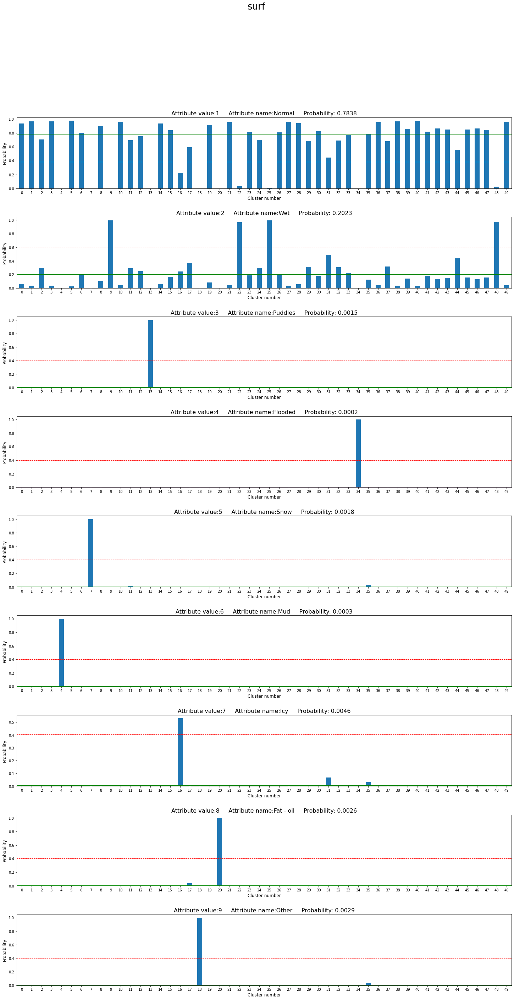

In [34]:
anomalies=analyse_attributes_values_in_clusters(kmeans_data,'surf',threshold=0.4)

In [95]:
surf_indices=anomalies.loc[anomalies['5']==1].index
#draw_more_frequent_anomalies_clusters(kmeans_data.loc[kmeans_data['cluster'].isin(surf_indices)],anomalies,'surf')

In [96]:
surf_indices=anomalies.loc[anomalies['8']==1].index
#draw_more_frequent_anomalies_clusters(kmeans_data.loc[kmeans_data['cluster'].isin(surf_indices)],anomalies,'surf')

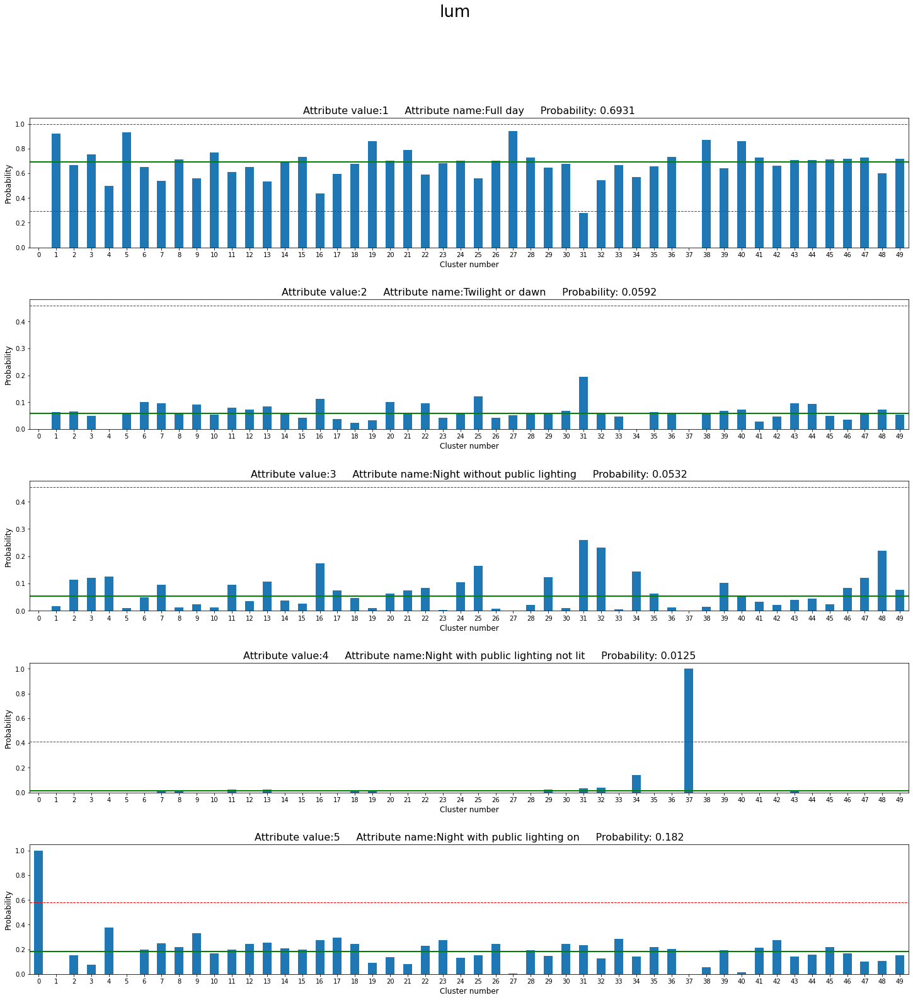

In [54]:
anomalies=analyse_attributes_values_in_clusters(kmeans_data,'lum',threshold=0.4)

In [97]:
lum_indices=anomalies.loc[anomalies['4']==1].index
#draw_more_frequent_anomalies_clusters(kmeans_data.loc[kmeans_data['cluster'].isin(lum_indices)],anomalies,'lum')

In [98]:
lum_indices=anomalies.loc[anomalies['5']==1].index
#draw_more_frequent_anomalies_clusters(kmeans_data.loc[kmeans_data['cluster'].isin(lum_indices)][:500],anomalies,'lum')

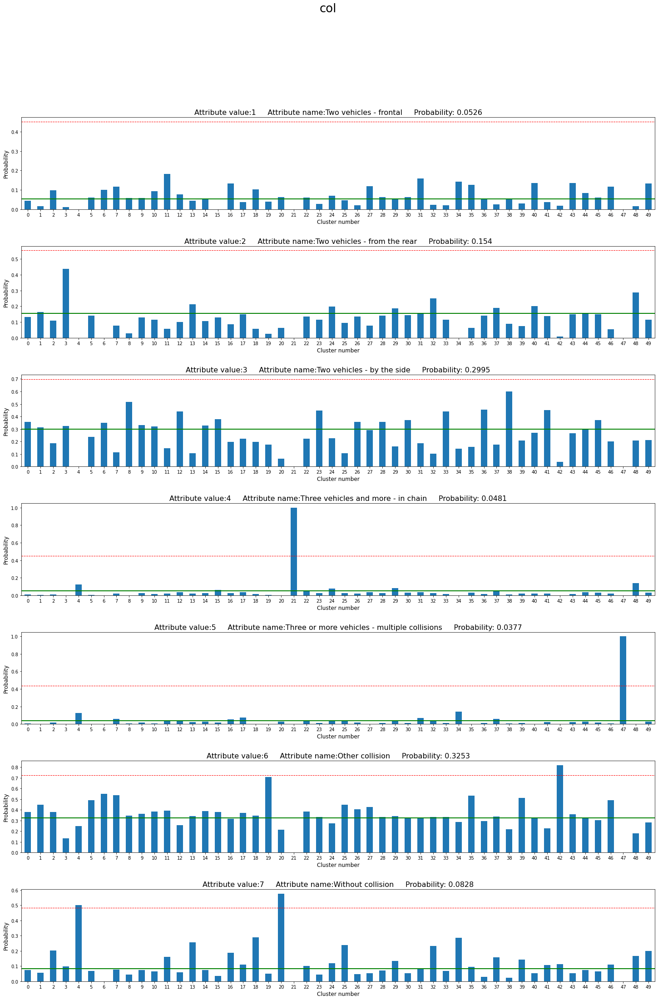

In [60]:
anomalies=analyse_attributes_values_in_clusters(kmeans_data,'col',threshold=0.4)

In [99]:
col_indices=anomalies.loc[anomalies['4']==1].index
#draw_more_frequent_anomalies_clusters(kmeans_data.loc[kmeans_data['cluster'].isin(col_indices)][:500],anomalies,'col')

In [100]:
col_indices=anomalies.loc[anomalies['5']==1].index
#draw_more_frequent_anomalies_clusters(kmeans_data.loc[kmeans_data['cluster'].isin(col_indices)][:500],anomalies,'col')

## Hierarchical clustering analysis

In [82]:
convert_column_to_string(hierarchical_data,['lum','surf','atm','col'])

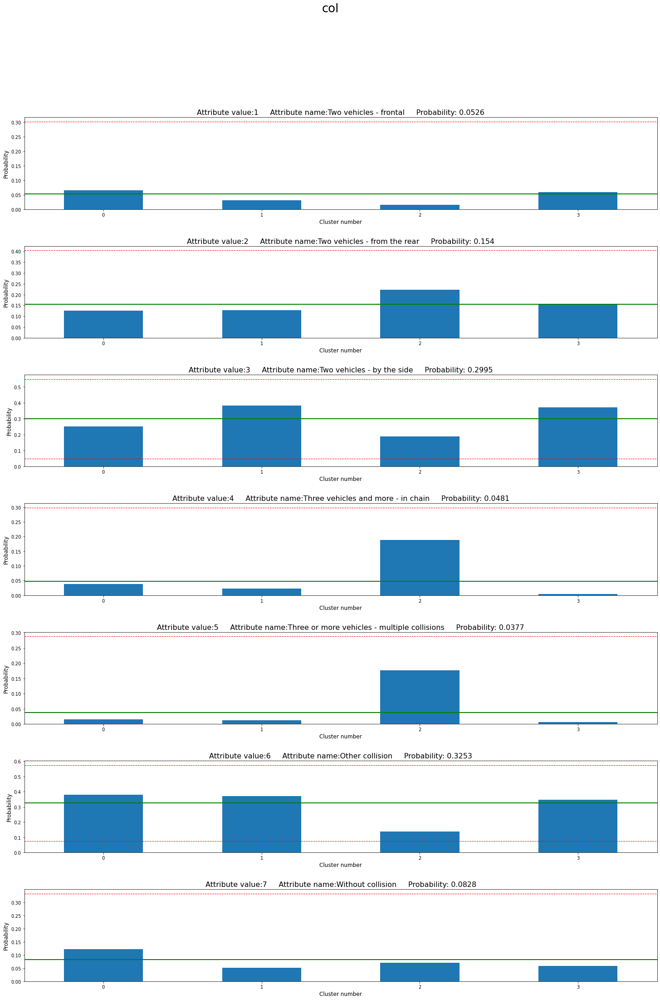

In [83]:
anomalies=analyse_attributes_values_in_clusters(hierarchical_data,'col',threshold=0.25)

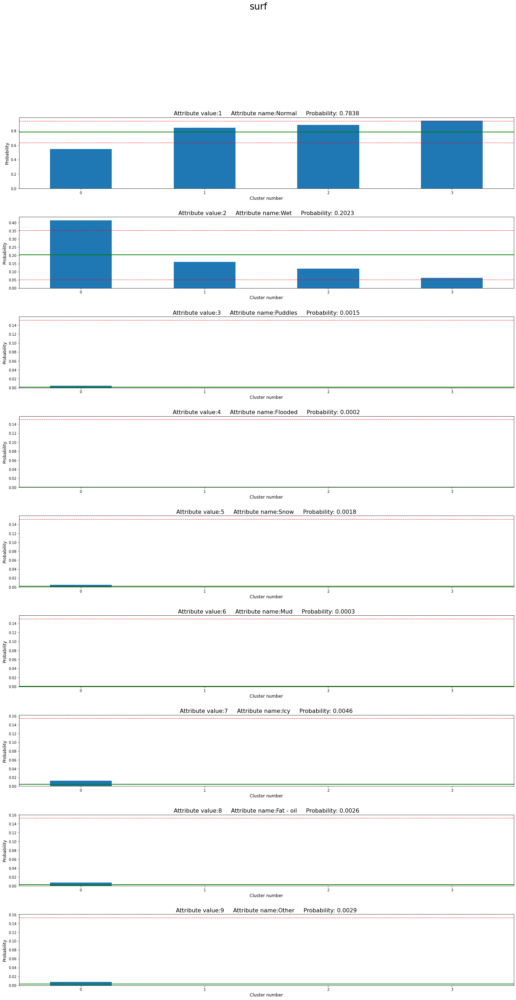

In [85]:
anomalies=analyse_attributes_values_in_clusters(hierarchical_data,'surf',threshold=0.15)

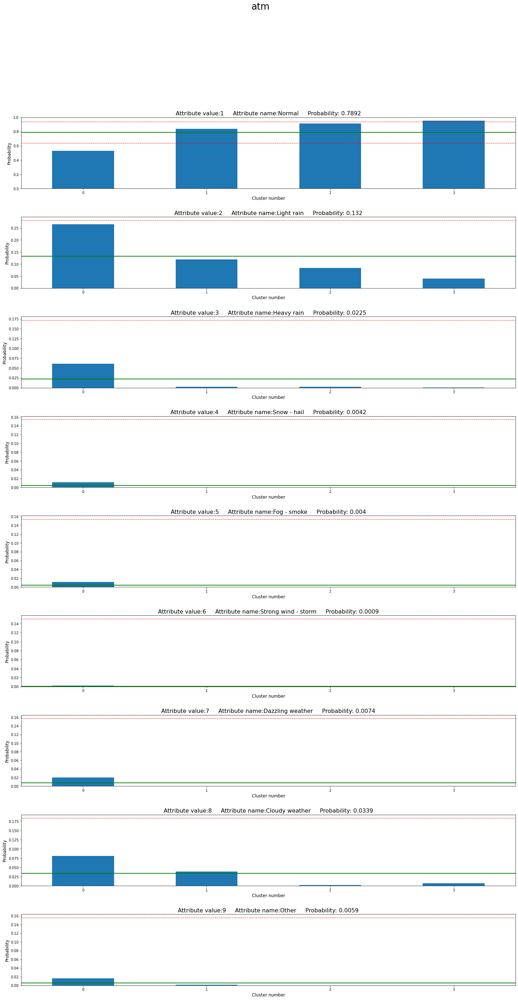

In [89]:
anomalies=analyse_attributes_values_in_clusters(hierarchical_data,'atm',threshold=0.15)

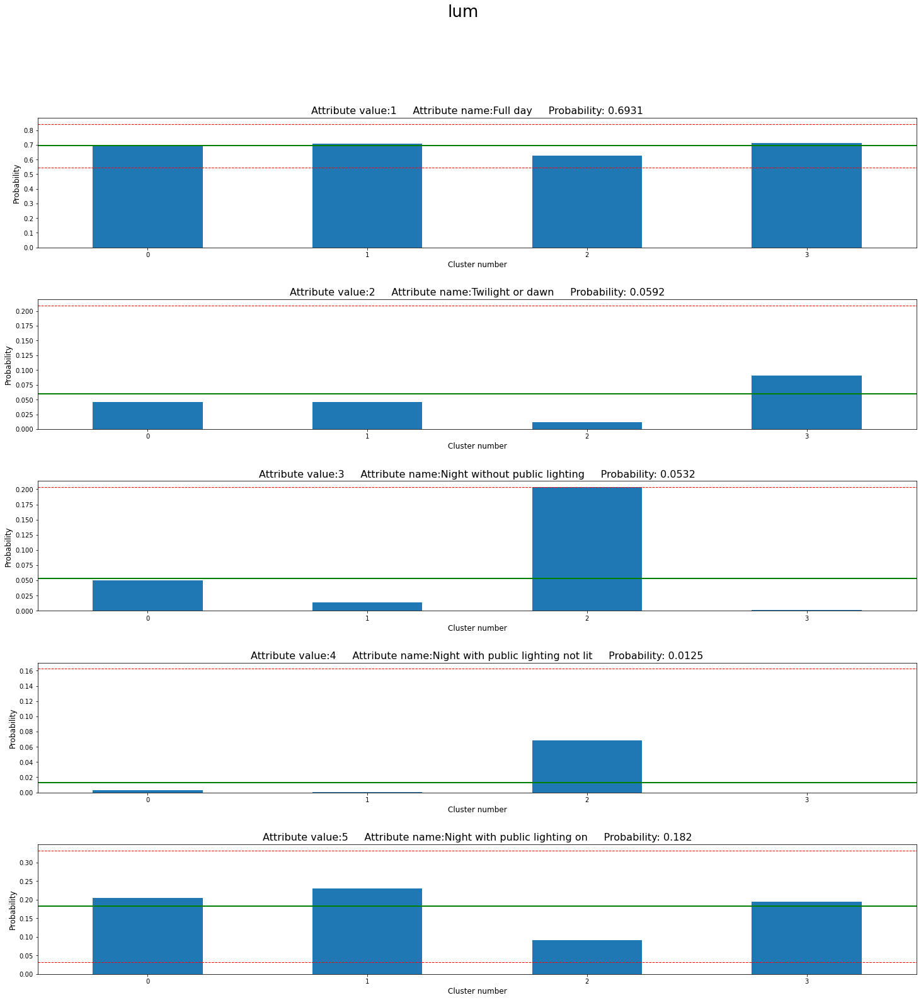

In [88]:
anomalies=analyse_attributes_values_in_clusters(hierarchical_data,'lum',threshold=0.15)

# 3D PCA Visualization 

In [212]:
def plot_3D(data,labels):
    pca_ = PCA(n_components=3)
    X = pca_.fit_transform(data)

    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(X[:,0],X[:,1],X[:,2], c=labels/5, cmap='viridis',edgecolor='k', s=100, alpha = 0.8)


    ax.set_title("PCA directions")
    ax.set_xlabel("Feature 1")
    ax.set_ylabel("Feature 2")
    ax.set_zlabel("Feature 3")
    ax.dist = 10
    plt.autoscale(enable=True, axis='x', tight=True)    

    plt.show()


## DBSCAN visualization 

In [187]:
vis_dbscan_data=dbscan_data.loc[dbscan_data['cluster']>-1]
labels=vis_dbscan_data['cluster']
vis_dbscan_data.drop(['Num_Acc','com','adr','gps','voie','v1','v2','pr','pr1','nbv','lartpc','larrout','cluster'],axis=1,inplace=True)

convert_column_to_string(vis_dbscan_data,['lum','int','atm','col','catr','circ','vosp','prof','plan','surf','situ'])
vis_dbscan_data=pd.get_dummies(vis_dbscan_data, columns=['lum', 'int','atm','col','catr','circ','vosp','prof','plan','surf','situ'])

scaler = StandardScaler()
vis_dbscan_data= scaler.fit_transform(vis_dbscan_data)

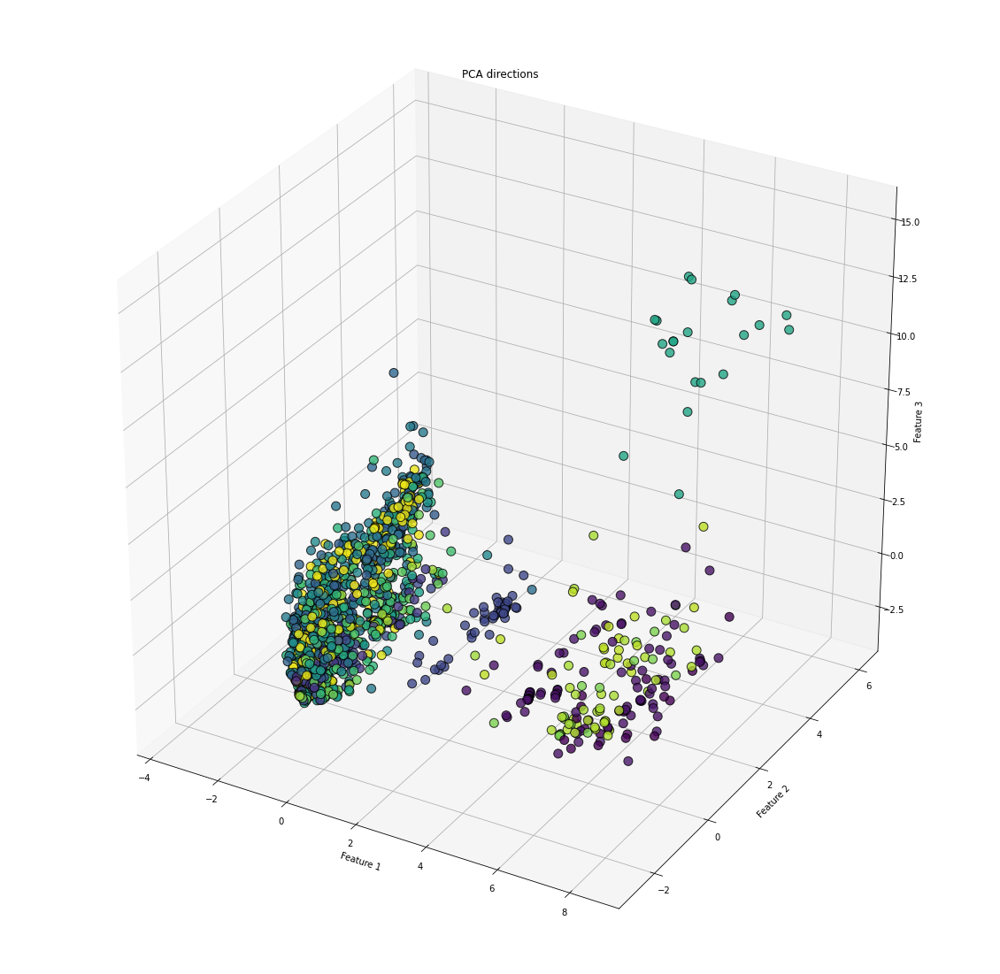

In [200]:
plot_3D(vis_dbscan_data,labels)

## KMEANS visualization 

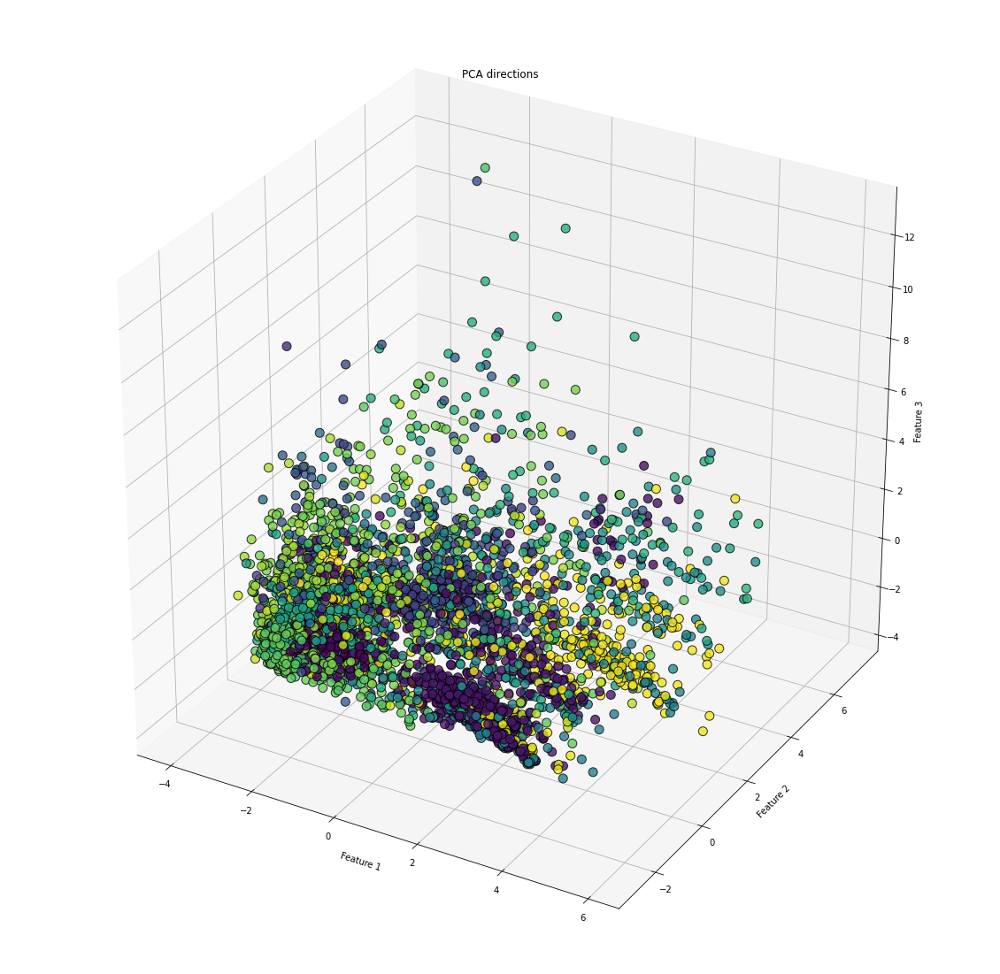

In [208]:
plot_3D(kmeans_one_hot_data[:4000],kmeans_data['cluster'][:4000])

## Hierarchical visualization 

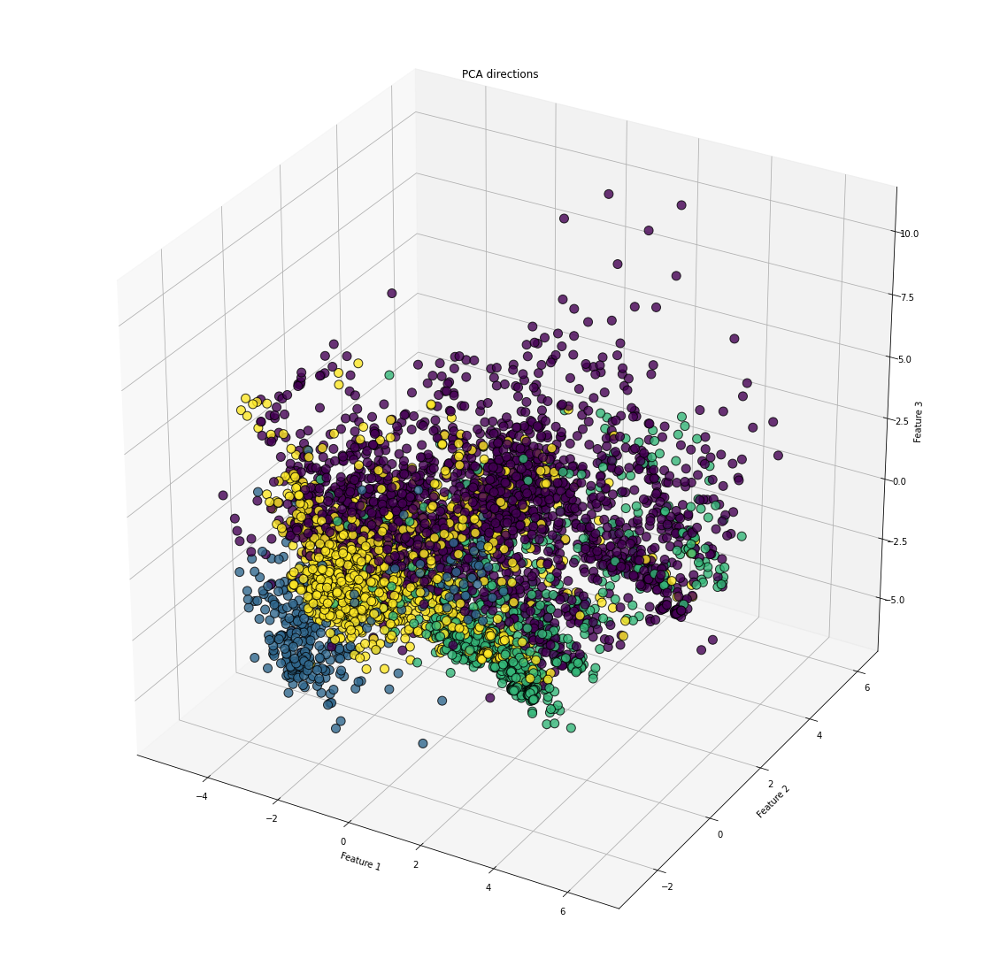

In [218]:
plot_3D(hierarchical_one_hot_data[:6000],hierarchical_data['cluster'][:6000])

# Analysis with classification 